## This notebook demonstrates the use of time-series L-band SAR backscatter from ALOS-2 data for extraction of forest above-ground biomass using a modified 3-parameter Water Cloud Model
#We use Machine Learning methods to clean the field data
#The steps are as follows
#1. The ALOS-2 data is converted to HDF5 format similar to NISAR using ISCE3
#2. The ALOS-2 data is processed in ISCE3 and the backscatter over the field plots is extracted. We use an improved
# RTC method. In the RTC process, the plot corners are projected to radar geometry, and sub-pixel aggregation of 
#backscatter is carried out. Further, this aggregation approach ensures that there is no mismatch between pixel 
#size and plot size, as even partially covered pixels are weighted according to their areal coverage. [Khati et al., Remote Sensing, 2020]
#3. There are many changes to the field during the 5 year ALOS-2 time-series
# Many plots have been logged and many have grown. We use a simple Machine Learning method to identify these plots and
# remove those. Please see the method "data_clean_local" for the code
#4. The time-series backscatter is modeled using the 3-parameter Water Cloud Model. This model is fitted using 
# least-squares minimization approach. We also use the Jacobians to ensure more accuracy in parameter retrival
#5. The AGB is modeled from the backscatter for each ALOS-2 acquisition.
#6. We use a simple aggregation of the AGB estimates from each acquisition of the time-series to improve AGB estimates

#Our results are summarized in our recently accepted publication: "Time-series L-band SAR and GEDI for forest 
#above-ground biomass mapping of sub-tropical forest”, by Unmesh Khati*, Marco Lavalle and Gulab Singh, 
#published in “Frontiers in Earth Science-Environmental Informatics and Remote Sensing”. 


In [2]:
import numpy as np #For mathematical operations
from osgeo import gdal #To handle raster data sets
import plant #A versatile toolbox which can handle raster data and perform a number of operations
from matplotlib import pyplot as plt #To visualize data
import matplotlib.pylab as pl 
from matplotlib.colors import ListedColormap
import matplotlib.patches as patches
from matplotlib.offsetbox import AnchoredText
import os, fnmatch #os (operating system) library is useful to perform os dependent functionality (change directory etc)
from datetime import datetime #For date and time data reading and manipulations
import datetime as dt
import pandas as pd #Powerful library to handle large datasets
from tqdm import tqdm #To track progress of iterations
from scipy import stats, ndimage #Scipy library helps scientific computing
from scipy.stats import gaussian_kde
from sklearn.metrics import mean_squared_error, r2_score, confusion_matrix,cohen_kappa_score #Sklearn packages import
#Importing some ML regression functions
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
#Model fitting and evaluation
from sklearn.model_selection import train_test_split
from lmfit import Model, Parameters
from scipy.optimize import least_squares
#Ignoring the warnings
import warnings
warnings.filterwarnings('ignore')
#Seaborn is also a good tool for plotting
import seaborn as sns


In [3]:
import matplotlib as mpl
from matplotlib.offsetbox import AnchoredText
mpl.rcParams['grid.color'] = '0.75'
mpl.rcParams['grid.linestyle'] = ':'
mpl.rcParams['grid.linewidth'] = 0.5
mpl.rcParams['figure.facecolor'] = '1'
mpl.style.use('default')
mpl.rcParams['axes.grid']=True
mpl.rcParams['lines.markersize']=10
mpl.rcParams['axes.titlesize']=16
mpl.rcParams['xtick.labelsize'] = 16
mpl.rcParams['ytick.labelsize'] = 16
mpl.rcParams['axes.labelsize'] = 16
mpl.rcParams['font.family'] = 'sans-serif'
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

## Study area location, field plots and weather station

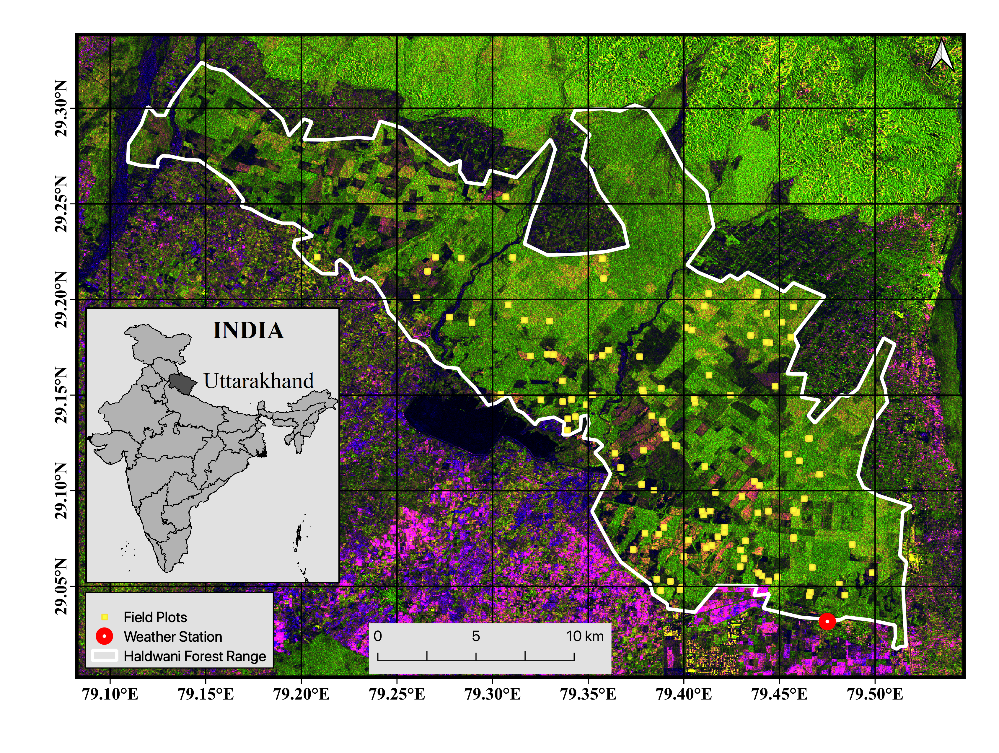

In [4]:
#1. Function to read the ALOS-2 acquisition dates
def read_alos2_dates():
    #Date info
    datefile = '/home/unmeshk/dat/Haldwani/ALOS2_subset/dates.txt'
    mydata = np.genfromtxt(datefile, delimiter=',')
    dates=[]
    for i in range(len(mydata)):
        dates.append(datetime.strptime(str(np.int(mydata[i][0])), "%Y%m%d"))
    return dates
dates = read_alos2_dates()

#2. Function to read the field data
def read_field_data(clean=False):
    #Import Field data CSV, merge with ALOS-2 backscatter to generate a dataframe
    field_path='/home/unmeshk/dat/Haldwani/ALOS2_agb_esa/Haldwani_AGB_polygon.shp.csv'
    df_field = pd.read_csv(field_path)
    df_field['SrNo']=np.arange(len(df_field))
    if clean==True:
        df_field=df_field.iloc[nonlogged_plot_index]
    return df_field

## Using a Machine Learning approach to remove outliers in the field data
### The outliers here include those plots which either were harvested during the time-series or show increase in AGB due to growth.

In [37]:
#3. Function to clean the data using a machine learning approach
def data_clean_local(X1, X2, y, w1_noise=20, w2_noise=10, num_algo=2):
    #Cleaning data
    # X1 = np.mean(dfC11[[x for x in dates]].to_numpy(), axis=1) #Mean HH
    # X2 = np.mean(dfC22[[x for x in dates]].to_numpy(), axis=1) #Mean HV
    X = np.array([X1, X2]).T #HH and HV data
    try:
        y = y.AGB.to_numpy()
    except:
        y = y

    #print(X.shape, y.shape)
    noise_threshold = w1_noise + w2_noise * 0.01 * y

    mdl1 = RandomForestRegressor(
        n_estimators=10,
        max_depth=6,
    )
    mdl2 = KNeighborsRegressor(n_neighbors=12)

    mdl3 = MLPRegressor(
        learning_rate_init=0.01,
        hidden_layer_sizes=(100, )
    )

    mdl_list = [mdl1, mdl2, mdl1]
    noise_list = []
    for mdl in mdl_list:
            estimators = [('scale', StandardScaler()), ('learn', mdl)]
            ppl = Pipeline(estimators)
            y_hat = ppl.fit(X, y).predict(X)
            y_c = np.int8(np.abs(y - y_hat) > noise_threshold)
            noise_list.append(y_c)

    noise0 = np.sum(np.stack(noise_list), axis=0)
    # post-preliminary, iteration
    noise = noise0
    noise_pool = []
    iter = 4
    for i in range(iter):
        Xtr = X[noise < num_algo, :]
        ytr = y[noise < num_algo]
        noise_list = []
        for mdl in mdl_list:
            estimators = [('scale', StandardScaler()), ('learn', mdl)]
            ppl = Pipeline(estimators)
            y_hat = ppl.fit(Xtr, ytr).predict(X)
            y_c = np.int8(np.abs(y - y_hat) > noise_threshold)
            noise_list.append(y_c)
            noise_pool.append(y_c)
        noise = np.sum(np.stack(noise_list), axis=0)

    noise = np.sum(np.stack(noise_pool), axis=0)
    idx = noise < num_algo * iter
    X_clean = X[noise < num_algo * iter, :]
    y_clean = y[noise < num_algo * iter]
    return X_clean, y_clean, idx

In [47]:
#3. Function to read the ALOS-2 data
def read_alos2_data(max_agb=300, clean=True):
    dates=read_alos2_dates()
    path ='/home/unmeshk/dat/Haldwani/ALOS2_agb_esa//'
    files = fnmatch.filter(os.listdir(path),"ALOS2_D_20*agb_polygon.bin")
    files.sort()
    def read_data(file):
        data=gdal.Open(path+file).ReadAsArray()
        C11=[np.absolute(data[i][0][0]) for i in range(len(data))]
        C22=[np.absolute(data[i][1][1]) for i in range(len(data))]
        return C11, C22    
    C11=[]
    C22=[]
    for file in files:
        x, y = read_data(file)
        C11.append(np.absolute(x))
        C22.append(np.absolute(y))
    dfC11 = pd.DataFrame(C11, index=dates).T
    dfC22 = pd.DataFrame(C22, index=dates).T
    m_t = dfC11.shape[1]
    df_field = read_field_data()
    dfC11['AGB'] = df_field.AGB
    dfC22['AGB'] = df_field.AGB

    df_field = read_field_data()
    logged_plot_index=np.unique(np.array([1, 2, 10, 16, 21, 25, 28, 34, 35, 44, 46, 48, 50, 53, 54, 55, 60, 67]))
    df_field = read_field_data()
    nonlogged_plot_index = [i for i in df_field.index.to_numpy() if i not in logged_plot_index]
    #Removing logged plots
    dfC11 = dfC11.loc[nonlogged_plot_index]
    dfC22 = dfC22.loc[nonlogged_plot_index]
    df_field = df_field.loc[nonlogged_plot_index]
    #Filtering out based on AGB if required
    df_field = df_field[dfC11.AGB<=max_agb]
    dfC11 = dfC11[dfC11.AGB<=max_agb]
    dfC22 = dfC22[dfC22.AGB<=max_agb]
    if('index' in dfC11.columns):
        dfC11.drop(columns=['index'], inplace=True)
        dfC22.drop(columns=['index'], inplace=True)
    m_t = len(dfC11.columns)-1
    AGB = dfC11.AGB.to_numpy()
    
    # Removing those plots which changed based on the function "data_clean_local"
    noise_list = []
    for date in dates[0:m_t]:
        Y_clean, X_clean, idx = data_clean_local(dfC11[date], dfC22[date],AGB, w1_noise=10, w2_noise=20, num_algo=2)
        noise_list.append(np.int8(idx))
    noise = np.sum(np.stack(noise_list),axis=0)
    cnt = np.ones(len(dfC11))
    idx = noise>5
    
    dfC11 = dfC11.drop(columns=['AGB'])
    dfC22 = dfC22.drop(columns=['AGB'])
    dfC11.reset_index(inplace=True, drop=True)
    dfC22.reset_index(inplace=True, drop=True)
    dfC11 = dfC11.T
    dfC22 = dfC22.T
    if clean == False:
        return dfC11, dfC22, AGB, m_t, df_field
    else:
        dfC11 = dfC11.T[idx].T
        dfC22 = dfC22.T[idx].T
        AGB = AGB[idx]
        return dfC11, dfC22, AGB, m_t, df_field
dfC11, dfC22, AGB, m_t, df_field = read_alos2_data(clean=True)
dfC22.head()

,0,2,4,5,6,7,8,11,12,13,...,84,85,86,87,88,90,91,92,94,95
2014-09-21 00:00:00,0.013663,0.010665,0.021520,0.052321,0.016510,0.057819,0.033046,0.043146,0.044212,0.071023,...,0.078193,0.122410,0.175248,0.082693,0.129060,0.069518,0.082773,0.060586,0.017464,0.053181
2014-11-30 00:00:00,0.011678,0.008093,0.006202,0.069010,0.005251,0.061884,0.023272,0.057423,0.036579,0.068929,...,0.078052,0.068993,0.082607,0.052479,0.062719,0.041949,0.073699,0.072168,0.016607,0.031699
2015-07-12 00:00:00,0.029327,0.036473,0.026282,0.090506,0.017546,0.054427,0.030229,0.069628,0.023490,0.073272,...,0.067174,0.109852,0.119778,0.104995,0.093900,0.112380,0.083854,0.056293,0.045700,0.077526
2015-09-20 00:00:00,0.025652,0.018543,0.026519,0.036228,0.010303,0.041470,0.035213,0.090893,0.003423,0.041092,...,0.063729,0.055275,0.070961,0.075982,0.129197,0.084208,0.076091,0.067842,0.042617,0.048375
2015-11-29 00:00:00,0.019338,0.018470,0.023509,0.075779,0.011201,0.056498,0.022299,0.086344,0.002915,0.058010,...,0.051620,0.041015,0.080772,0.102339,0.121609,0.078527,0.074623,0.097635,0.079177,0.046397


In [6]:
#4. Function to read the weather information
def read_weather_data_local(tdelta=7):
    #Import weather data
    # Read precipitation data
    import datetime as dt
    weather_path = '/home/unmeshk/dat/Haldwani/ALOS2_agb_esa/data_SM_P_Lavalle_NIndia.txt'
    df=pd.read_csv(weather_path)
    del df['Unnamed: 0']
    df["SWI_ASCAT"] = pd.to_numeric(df["SWI_ASCAT"], downcast="float",errors='coerce')
    df["SMERASLand"] = pd.to_numeric(df["SMERASLand"], downcast="float",errors='coerce')
    df["SM2R_ASC_mm"] = pd.to_numeric(df["SM2R_ASC_mm"], downcast="float",errors='coerce')
    df["GPM_ASC_mm"] = pd.to_numeric(df["GPM_ASC_mm"], downcast="float",errors='coerce')
    df["PERAS_mm"] = pd.to_numeric(df["PERAS_mm"], downcast="float",errors='coerce')
    dts = df['Date_matlab'].apply(lambda Date_matlab: dt.datetime.fromordinal(int(Date_matlab)) + 
                                    dt.timedelta(days=Date_matlab%1) - dt.timedelta(days = 366))
    del df['Date_matlab']
    tindex=pd.DatetimeIndex(dts)
    df.index = tindex
    #Taking cumulative mean of parameters 48 hours prior
    tdelta = tdelta #Days

    #Subset wrt L-band
    data=[]
    for i in range(len(dates)):
        dt1=dates[i]-dt.timedelta(days=tdelta)
        dt1=dt1.strftime("%Y-%m-%d")
        dt2=dates[i].strftime("%Y-%m-%d")
        data.append(df[dt1:dt2].mean())
    dfL=pd.DataFrame(data,index=dates)

    weather_path = '/home/unmeshk/dat/Haldwani/ALOS2_agb_esa/OpenWeatherMap_Pantnagar.csv'
    weather_path = '/home/unmeshk/dat/Haldwani/ALOS2_agb_esa/Pantnagar_Airport_Weather.csv'
    df_rain = pd.read_csv(weather_path).fillna(value = 0)
    try:
        df_rain['date'] = df_rain['date'].apply(lambda x:dt.datetime.strptime(x, '%Y-%m-%d %H:%M:%S'))
    except:
        df_rain['date'] = df_rain['dt_iso'].apply(lambda x:dt.datetime.strptime(x.split(' +')[0], '%Y-%m-%d %H:%M:%S'))
    df_rain.index = df_rain['date']
    df_rain['rain']=df_rain['rain_1h']+df_rain['rain_3h']
    data=[]
    for i in range(len(dates)):
        dt1=dates[i]-dt.timedelta(days=tdelta)
        dt1=dt1.strftime("%Y-%m-%d")
        dt2=dates[i].strftime("%Y-%m-%d")
        data.append(df_rain[dt1:dt2].sum())
    dfL = pd.concat([dfL, pd.DataFrame(data, index=dates)],axis=1)
    dfL['month'] = dfL.index.month
    dfL['year'] = dfL.index.year
    return dfL
dfL= read_weather_data_local(tdelta=7)

weather_path = '/home/unmeshk/dat/Haldwani/ALOS2_agb_esa/data_SM_P_Lavalle_NIndia.txt'
dfw=pd.read_csv(weather_path)
del dfw['Unnamed: 0']
dfw["SWI_ASCAT"] = pd.to_numeric(dfw["SWI_ASCAT"], downcast="float",errors='coerce')
dfw["SMERASLand"] = pd.to_numeric(dfw["SMERASLand"], downcast="float",errors='coerce')
dfw["SM2R_ASC_mm"] = pd.to_numeric(dfw["SM2R_ASC_mm"], downcast="float",errors='coerce')
dfw["GPM_ASC_mm"] = pd.to_numeric(dfw["GPM_ASC_mm"], downcast="float",errors='coerce')
dfw["PERAS_mm"] = pd.to_numeric(dfw["PERAS_mm"], downcast="float",errors='coerce')
dts = dfw['Date_matlab'].apply(lambda Date_matlab: dt.datetime.fromordinal(int(Date_matlab)) +
                                dt.timedelta(days=Date_matlab%1) - dt.timedelta(days = 366))
del dfw['Date_matlab']
tindex=pd.DatetimeIndex(dts)
dfw.index = tindex
weather_path = '/home/unmeshk/dat/Haldwani/ALOS2_agb_esa/Pantnagar_Airport_Weather.csv'
df_rain = pd.read_csv(weather_path).fillna(value = 0)
df_rain['date'] = df_rain['dt_iso'].apply(lambda x:dt.datetime.strptime(x.split(' +')[0], '%Y-%m-%d %H:%M:%S'))
df_rain.index = df_rain['date']
df_rain[df_rain.rain_1h=='NaN']=0
df_rain[df_rain.rain_3h=='NaN']=0

df_rain['rain']=df_rain['rain_1h']+df_rain['rain_3h']
df_rain=df_rain.loc[dt.datetime(2014,1,1):dt.datetime(2020,12,31)]
d = {'dt':'first', 'city_name':'first', 'lat':'first', 'lon':'first', 'temp':'mean',
       'temp_min':'mean', 'temp_max':'mean', 'pressure':'mean','humidity':'mean', 'wind_speed':'mean',
        'wind_deg':'mean', 'rain_1h':'sum','rain_3h':'sum', 'rain':'sum','clouds_all':'sum'}
df_rain_gp = df_rain.groupby(by=df_rain.index.date).agg(d)
df_rain_gp.index = pd.to_datetime(df_rain_gp.index)
df_rain.columns, df_rain_gp.columns
dfL.head(5)

,SWI_ASCAT,SMERASLand,SM2R_ASC_mm,GPM_ASC_mm,PERAS_mm,dt,dt_iso,timezone,city_name,lat,...,snow_1h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon,rain,month,year
2014-09-21,0.617085,0.564747,3.9250,2.541250,1.072015,270911347200,2014-09-14 00:00:00 +0000 UTC2014-09-14 01:00:...,3801600,Pantnagar AirportPantnagar AirportPantnagar Ai...,5574.437184,...,0.0,0.0,2960,147117,CloudsCloudsCloudsCloudsCloudsCloudsCloudsRain...,scattered cloudsfew cloudsscattered cloudsfew ...,03n02d03d02d02d03d03d10d02d02d02d02d02d02n01n0...,11.78,9,2014
2014-11-30,0.343925,0.032481,0.1125,0.000000,0.001514,272072563200,2014-11-23 00:00:00 +0000 UTC2014-11-23 01:00:...,3801600,Pantnagar AirportPantnagar AirportPantnagar Ai...,5574.437184,...,0.0,0.0,142,153607,CloudsCloudsCloudsCloudsClearClearClearClearCl...,scattered cloudsscattered cloudsscattered clou...,03n03n03d02d01d01d01d01d01d01d01d01d01n01n01n0...,0.00,11,2014
2015-07-12,0.745414,0.936396,22.3750,16.608749,12.839516,275788454400,2015-07-05 00:00:00 +0000 UTC2015-07-05 01:00:...,3801600,Pantnagar AirportPantnagar AirportPantnagar Ai...,5574.437184,...,0.0,0.0,18210,120035,CloudsCloudsCloudsCloudsCloudsCloudsRainRainRa...,few cloudsfew cloudsfew cloudsscattered clouds...,02d02d02d03d03d04d10d10d10d10d10d10d10d10d10n1...,106.36,7,2015
2015-09-20,0.552209,0.487485,2.8500,1.936250,2.161036,276949670400,2015-09-13 00:00:00 +0000 UTC2015-09-13 01:00:...,3801600,Pantnagar AirportPantnagar AirportPantnagar Ai...,5574.437184,...,0.0,0.0,7304,142464,CloudsCloudsCloudsCloudsCloudsCloudsCloudsClou...,broken cloudsbroken cloudsovercast cloudsbroke...,04n04d04d04d04d03d03d02d03d03d02d10d03d04n04n0...,16.87,9,2015
2015-11-29,0.355675,0.032498,0.1000,0.052500,0.113968,278110886400,2015-11-22 00:00:00 +0000 UTC2015-11-22 01:00:...,3801600,Pantnagar AirportPantnagar AirportPantnagar Ai...,5574.437184,...,0.0,0.0,11838,154105,CloudsCloudsCloudsCloudsCloudsCloudsCloudsClou...,overcast cloudsbroken cloudsovercast cloudsbro...,04n04n04d04d04d04d04d04d04d04d04d04d03n03n02n0...,0.00,11,2015


## PLotting the mean backscatter with respect to the weather information

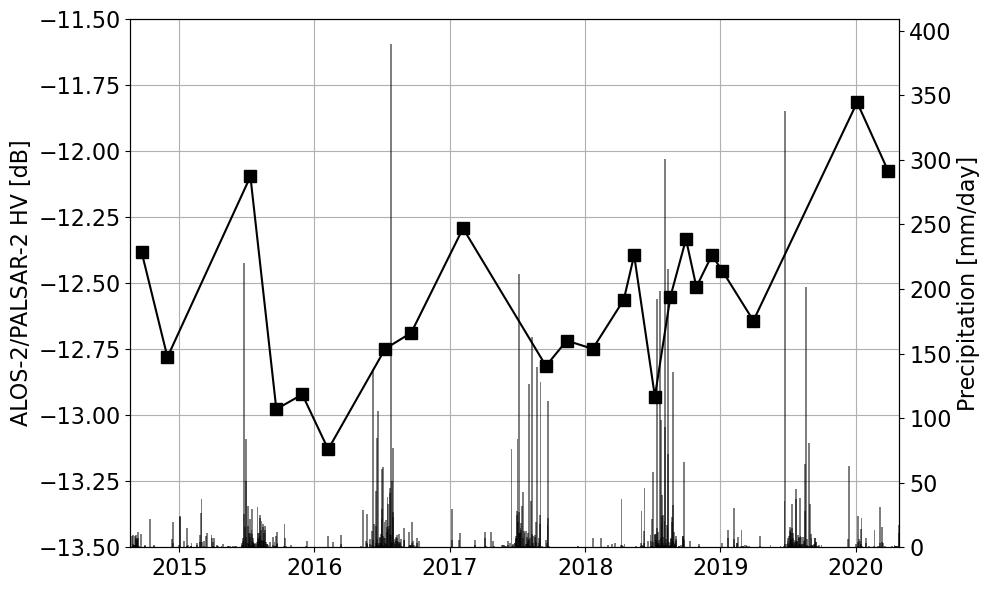

In [7]:
path='/home/unmeshk/dat/Haldwani/ALOS2_subset/'
files=fnmatch.filter(os.listdir(path),"ALOS2_D_*_geo_25m_diag.bin")
files.sort()
mean_img_hv = []
for file in files:
    ds = gdal.Open(path+file).ReadAsArray() #Over Pantnagar airport rain guage and forest
    ds[np.isinf(ds)]=np.nan
    mean_img_hv.append(np.nanmean(ds))
mean_img_hv = np.array(mean_img_hv)
fig, ax = plt.subplots(1,1,figsize=(10,6))
#ax.bar(df_rain_gp.loc[dfL.index].index, df_rain_gp.loc[dfL.index].rain, width=20, alpha=0.5, color='k')
ax.plot(dfL.index, 10*np.log10(mean_img_hv), marker='s', color='k', markersize=8)
ax2 = ax.twinx()
ax2.bar(df_rain_gp.index, df_rain_gp.rain, width=5, alpha=0.5, color='k')
ax2.set_xlim(dfL.index[0]- dt.timedelta(days=30), dfL.index[-1]+ dt.timedelta(days=30))
ax.set_ylim(-13.5,-11.5)
ax2.grid(None)
#ax2.plot(dfL.index,dfC22.mean(axis=1), marker='s')
_=plt.xticks(rotation=25)
ax2.set_ylabel('Precipitation [mm/day]')
ax.set_ylabel('ALOS-2/PALSAR-2 HV [dB]')
plt.tight_layout()


In [8]:
def percentile(n):
    def percentile_(x):
        return np.percentile(x, n)
    percentile_.__name__ = 'percentile_%s' % n
    return percentile_

dfC11, dfC22, AGB, m_t, df_field = read_alos2_data(max_agb=300)

for date in dates[0:m_t]:
    Y_clean, X_clean, idx = data_clean_local(dfC11[date], dfC22[date],agb, w1_noise=10, w2_noise=20, num_algo=2)
    noise_list.append(np.int8(idx))
noise = np.sum(np.stack(noise_list),axis=0)
print(dfC11.shape, df_field.shape)    
os.chdir('/home/unmeshk/dat/notebooks/data/')
idx = noise>5
AGB = dfC11.AGB.to_numpy()
dfC11 = dfC11.drop(columns=['AGB'])
dfC22 = dfC22.drop(columns=['AGB'])
dfC11 = dfC11.T
dfC22 = dfC22.T

dfC11.head()

,0,1,2,3,4,5,6,7,8,9,...,67,68,69,70,71,72,73,74,75,76
2014-09-21 00:00:00,0.243118,0.082266,0.088797,0.640302,0.172564,0.887491,0.124162,0.266792,0.349556,0.308112,...,0.679992,0.633544,0.320966,0.392892,0.261175,0.367815,0.543404,0.403163,0.184254,0.382999
2014-11-30 00:00:00,0.140161,0.052515,0.040698,0.373059,0.065956,0.996229,0.137456,0.272782,0.417219,0.383792,...,0.297102,0.358692,0.337965,0.510539,0.160659,0.268593,0.320646,0.281846,0.060500,0.219423
2015-07-12 00:00:00,0.183083,0.199094,0.249375,0.595868,0.149457,0.781542,0.224683,0.564832,0.285409,0.606148,...,0.689473,0.441799,0.379931,0.751591,0.321983,0.620965,1.294056,0.498097,0.159665,0.638339
2015-09-20 00:00:00,0.129551,0.090398,0.090595,0.410575,0.092192,0.611503,0.161426,0.311048,0.256539,0.398953,...,0.475908,0.322781,0.192461,0.656750,0.157228,0.408915,0.453017,0.312316,0.229278,0.333830
2015-11-29 00:00:00,0.137915,0.089681,0.087228,0.347967,0.088859,0.791772,0.134972,0.274721,0.528021,0.633490,...,0.214979,0.356558,0.213625,0.439844,0.177291,0.337888,0.353468,0.356059,0.247769,0.250634


In [9]:
def wcm(W, A, B, C):
    return A * np.exp(-C * W)+ B * (1-np.exp(-C * W))


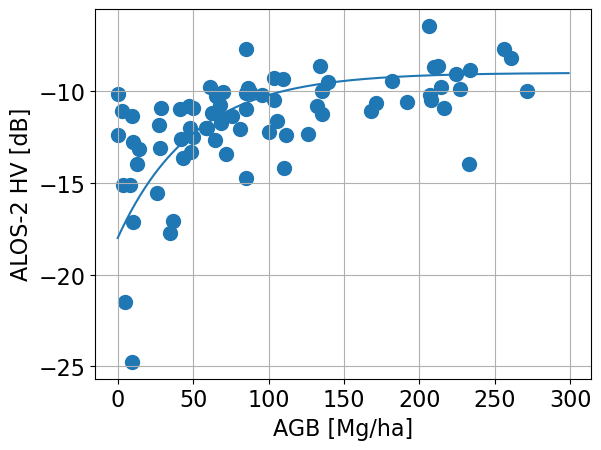

In [10]:
plt.scatter(AGB, 10*np.log10(dfC22.iloc[21]))
plt.xlabel('AGB [Mg/ha]')
plt.ylabel('ALOS-2 HV [dB]')
W = np.arange(300)
A = -18
B = -9
C = 0.02
plt.plot(W, wcm(W, A, B, C))

In [11]:
class Retrieval:
    def wcm_model(self, W, x):
        A = x[0]
        B = x[1]
        C = x[2]
        model_fun = A * np.exp(-C * W)+ B * (1-np.exp(-C * W))
        return model_fun
    def jac(self,x,W,y):
        a=x[0];b=x[1];c=x[2]
        J = np.empty((len(W),3))
        J[:,0] = np.exp(-c*W)
        J[:,1] = 1 - np.exp(-c*W)
        J[:,2] = -a*W*np.exp(-c*W) + b*W*np.exp(-c*W)
        return J
    def fun(self, x, W, y):
        return self.wcm_model(W, x)- y
    def model_inverse_single(self, y1, W1):
        def model_inversion(y1, W1):
            y = y1 #backscatter
            W = W1 #AGB
            fit_params = Parameters()
            fit_params.add('A', value=-20)#, min=-30, max=-5)
            fit_params.add('B', value=-10)#, min=-20, max=-2)
            fit_params.add('C', value=0.02)#, min=0.0001, max=0.5)
            result = least_squares(self.fun, 
                                   fit_params, args=(W,y), jac=self.jac,
                                   bounds=([-30, -20, 0.0001], [-5, -2, .5]))
            param0 = result.x
            #print(f'A, B and C = {param0}')
            y_hat0 = self.wcm_model(W, param0)
            param0 = np.array(param0)
            y_hat0 = np.array(y_hat0)
            return param0, y_hat0
        params, y_hat = model_inversion(y1, W1)
        return params, y_hat
    def data_inverse_single(self, y, params):
        A = params[0]
        B = params[1]
        C = params[2]
        y1 = y
        dummy_agb = (y1*100)**2
        y1 = 10*np.log10(y1)
        agb=(-1/C)*np.log((y1-B)/(A-B))
        agb[agb<0] = 0
        agb[np.isnan(agb)] = dummy_agb[np.isnan(agb)]
        agb = np.array(agb)
        return agb
    
    def model_inverse(self, y1, W1):
        def model_inversion(instance):
            y = y1[instance,:]
            W = W1
            fit_params = Parameters()
            fit_params.add('A', value=-20)#, min=-30, max=-5)
            fit_params.add('B', value=-10)#, min=-20, max=-2)
            fit_params.add('C', value=0.02)#, min=0.0001, max=0.5)
            result = least_squares(self.fun, 
                                   fit_params, args=(W,y), jac=self.jac,
                                   bounds=([-30, -20, 0.0001], [-5, -2, .5]))
            param0 = result.x
            #print(param0)
            y_hat0 = self.wcm_model(W, param0)
            return param0, y_hat0
        params = []
        y_hat = []
        for i in range(y1.shape[0]):
            a, b = model_inversion(i)
            params.append(a.flatten())
            y_hat.append(b)
        params = np.array(params)
        y_hat = np.array(y_hat)
        return params, y_hat
    def data_inverse(self, y, params):
        def data_inversion(instance):
            A = params[instance, 0]
            B = params[instance, 1]
            C = params[instance, 2]
            y1 = y[:, instance]
            dummy_agb  = (y1*100)**2
            y1 = 10*np.log10(y1)
            #print(A, B, C, A.shape)
            agb=(-1/C)*np.log((y1-B)/(A-B))
            agb[agb<0] = 0
            agb[np.isnan(agb)] = dummy_agb[np.isnan(agb)]
            return agb
        AGB = []
        for i in range(params.shape[0]):
            AGB.append(data_inversion(i))
        AGB = np.array(AGB)
        return AGB

In [14]:
dfC11, dfC22, AGB, m_t, df_field = read_alos2_data(max_agb=300)
m_t

23

## Plotting the biomass as a function of backscatter

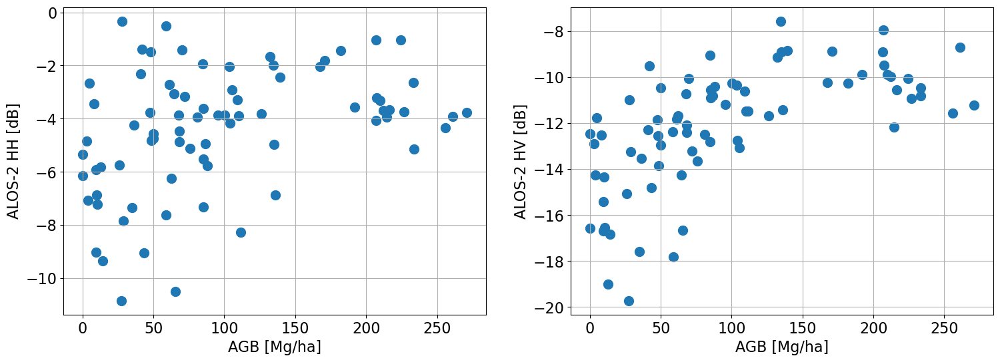

In [15]:
#Select the date for which to process the data

date = dates[0]

fig, [ax, ax2] = plt.subplots(1,2,figsize=(18,6))
dfC11_db = 10*np.log10(dfC11)
dfC22_db = 10*np.log10(dfC22)
ax.scatter(AGB, dfC11_db.loc[date])
ax.set_xlabel('AGB [Mg/ha]')
ax.set_ylabel('ALOS-2 HH [dB]')
ax.grid(True)
ax2.scatter(AGB, dfC22_db.loc[date])

ax2.set_xlabel('AGB [Mg/ha]')
ax2.set_ylabel('ALOS-2 HV [dB]')
ax2.grid(True)

## Running the WCM model with test-train splitting

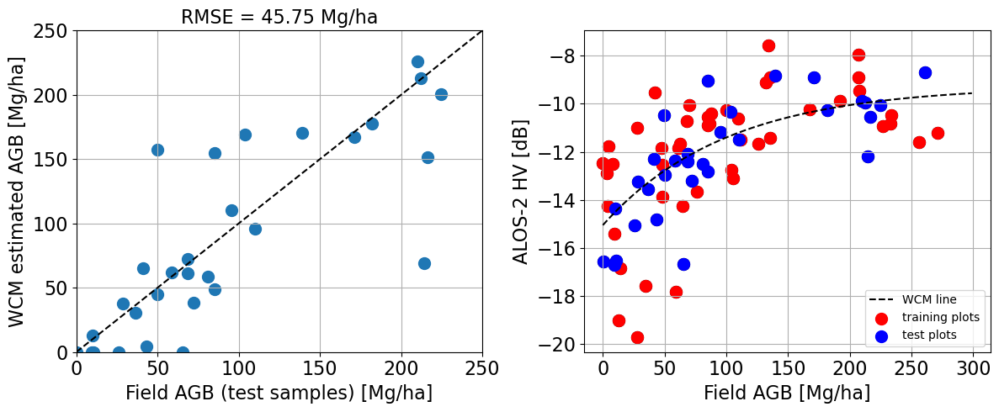

In [16]:
mdl00 = Retrieval()
backscatter = dfC22.loc[date]
y_train,y_test, agb_train, agb_test  = train_test_split(backscatter, AGB, test_size=0.4,
                                random_state = np.random.randint(10,1000),
                                shuffle = True)
#Model training
params, y_hat = mdl00.model_inverse_single(10*np.log10(y_train), agb_train)
#Model inversion
est = mdl00.data_inverse_single(y_test, params)
rmse = np.sqrt(mean_squared_error(est, agb_test))
rsq = r2_score(est, agb_test)
fig, [ax, ax2] = plt.subplots(1,2, figsize=(12,5))
ax.scatter(agb_test, est)
ax.plot(np.arange(300), np.arange(300), 'k--')
ax.set_xlim(0,250)
ax.set_ylim(0,250)
ax.set_xlabel('Field AGB (test samples) [Mg/ha]')
ax.set_ylabel('WCM estimated AGB [Mg/ha]')
ax.grid(True)
ax.set_title(f'RMSE = {rmse:.2f} Mg/ha')

ax2.scatter(AGB, 10*np.log10(backscatter), color='k')
ax2.scatter(agb_train, 10*np.log10(y_train), color='r', label='training plots')
ax2.scatter(agb_test, 10*np.log10(y_test), color='b', label='test plots')
WCM_line = mdl00.wcm_model(np.arange(300), params)
ax2.plot(WCM_line, 'k--', label='WCM line')
ax2.set_xlabel('Field AGB [Mg/ha]')
ax2.set_ylabel('ALOS-2 HV [dB]')
_=ax2.legend()
plt.tight_layout()

## The WCM model is run iteratively for one date to capture the modeling error more effectively

### We define a function to help us do the iterations

In [17]:
def train_test_model(date):
    y_train,y_test, agb_train, agb_test  = train_test_split(dfC22.loc[date].to_numpy().T, AGB, 
                                            test_size=0.4, random_state = np.random.randint(10,1000),
                                            shuffle = True)
    #Model training
    params, y_hat = mdl00.model_inverse_single(10*np.log10(y_train), agb_train)
    #Model inversion
    est = mdl00.data_inverse_single(y_test, params)
    rmse = np.sqrt(mean_squared_error(est, agb_test))
    rsq = r2_score(est, agb_test)
    est_all = mdl00.data_inverse_single(dfC22.loc[date].to_numpy(), params)
    rmse_all = np.sqrt(mean_squared_error(est_all, AGB))
    rsq_all = r2_score(est_all, AGB)
    return params, y_hat, est_all, rmse_all, rsq_all, AGB

100%|██████████| 50/50 [00:00<00:00, 243.73it/s]


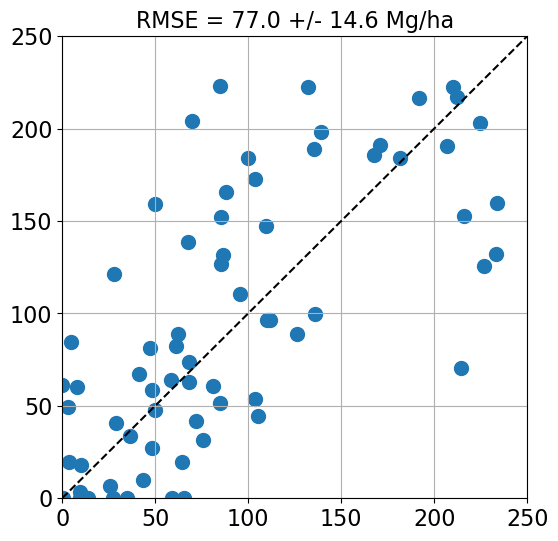

In [18]:
#Estimating WCM parameters, estimated backscatter, estimated AGB etc for each acquisition
params = []
y_hat = []
est = []
rmse = []
rsq = []
agb_test = []
#Iterating 30 times selecting random train/test samples
for iteration in tqdm(range(50)):
    a, b, c, d, e, f = train_test_model(date)
    params.append(a)
    y_hat.append(b)
    est.append(c)
    rmse.append(d)
    rsq.append(e)
    agb_test.append(f)
params = np.array(params)
y_hat = np.array(y_hat)
est = np.array(est)
rmse = np.array(rmse)
rsq = np.array(rsq)
agb_test = np.array(agb_test)
plt.figure(figsize=(6,6))
plt.scatter(np.nanmean(agb_test, axis=0), np.nanmean(est, axis=0))
plt.title(f'RMSE = {np.nanmean(rmse):.1f} +/- {np.nanstd(rmse):.1f} Mg/ha')
plt.plot(np.arange(300), np.arange(300), 'k--')
plt.xlim(0,250)
plt.ylim(0,250)
plt.grid(True)

## Defining a function which would take the ALOS-2 acquisition date as input and estimate the WCM modeled AGB

In [19]:
def estimate_agb(date, ax=None):
    params = []
    y_hat = []
    est = []
    rmse = []
    rsq = []
    agb_test = []
    #Iterating 30 times selecting random train/test samples
    for iteration in range(50):
        a, b, c, d, e, f = train_test_model(date)
        params.append(a)
        y_hat.append(b)
        est.append(c)
        rmse.append(d)
        rsq.append(e)
        agb_test.append(f)
    params = np.array(params)
    y_hat = np.array(y_hat)
    est = np.array(est)
    rmse = np.array(rmse)
    rsq = np.array(rsq)
    agb_test = np.array(agb_test)
    if ax == None:
        fig, ax = plt.subplots(1, 1, figsize=(6,6))
    ax.scatter(np.nanmean(agb_test, axis=0), np.nanmean(est, axis=0))
    ax.set_title(f'Date: {date.date()} \nRMSE = {np.nanmean(rmse):.1f} +/- {np.nanstd(rmse):.1f} Mg/ha', pad=15)
    ax.plot(np.arange(300), np.arange(300), 'k--')
    ax.set_xlim(0,250)
    ax.set_ylim(0,250)
    ax.set_xlabel('Field AGB [Mg/ha]')
    ax.set_ylabel('WCM estimated AGB [Mg/ha]')
    ax.grid(True)
    plt.tight_layout()
    return np.nanmean(rmse), np.nanmean(est, axis=0), np.nanmean(agb_test, axis=0)

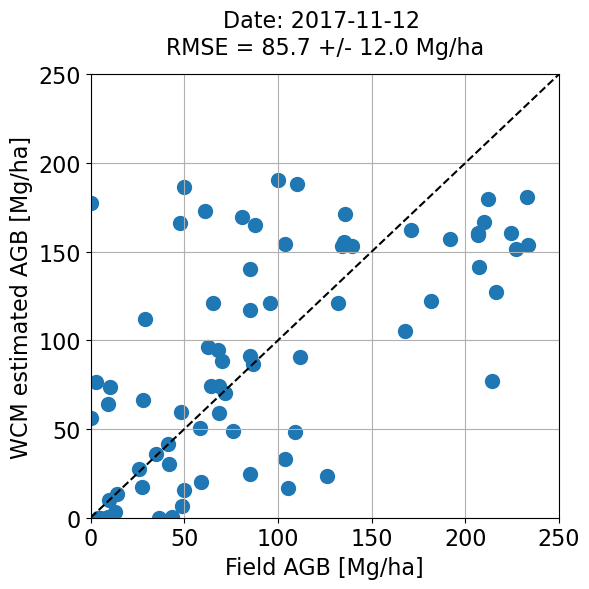

In [20]:
date = dates[10]
_=estimate_agb(date)

## Estimating AGB for all the dates

23it [00:08,  2.87it/s]


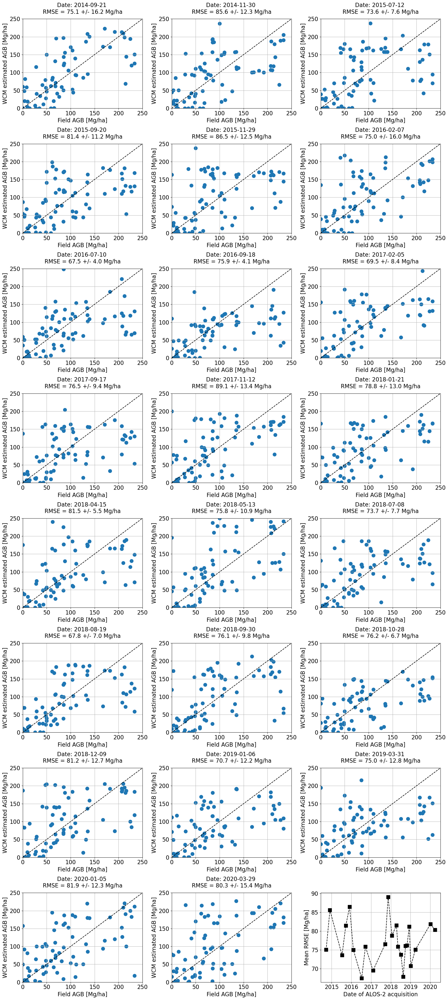

In [21]:
fig, axs = plt.subplots(8, 3, figsize=(18, 40))
rmse = []
agb = []
est = []
for date, ax in tqdm(zip(dates, axs.ravel())):
    t1, t2, t3 = estimate_agb(date, ax)
    rmse.append(t1)
    est.append(t2)
    agb.append(t3)
rmse = np.array(rmse)
est = np.array(est)
agb = np.array(agb)

ax = axs.ravel()[-1]
ax.plot(dates, rmse, marker='s', ls='--', color='k')
ax.set_xlabel('Date of ALOS-2 acquisition')
ax.set_ylabel('Mean RMSE [Mg/ha]')
ax.grid(True)


## Averaging AGB estimates from multiple acquisitions

In [22]:
def average_agb(t=1, ax=None):
    avg_est = np.nanmean(est[0:t, :], axis=0)
    rmse = np.sqrt(mean_squared_error(agb[0,:], avg_est))
    if ax == None:
        fig, ax = plt.subplots(1, 1, figsize=(6,6))
    ax.scatter(agb[0,:], avg_est)
    ax.set_title(f'Dates averaged: {t} \nRMSE = {rmse:.1f} Mg/ha', pad=15)
    ax.plot(np.arange(300), np.arange(300), 'k--')
    ax.set_xlim(0,300)
    ax.set_ylim(0,300)
    ax.grid(True)
    plt.tight_layout()
    return rmse

### Average over N acquisitions

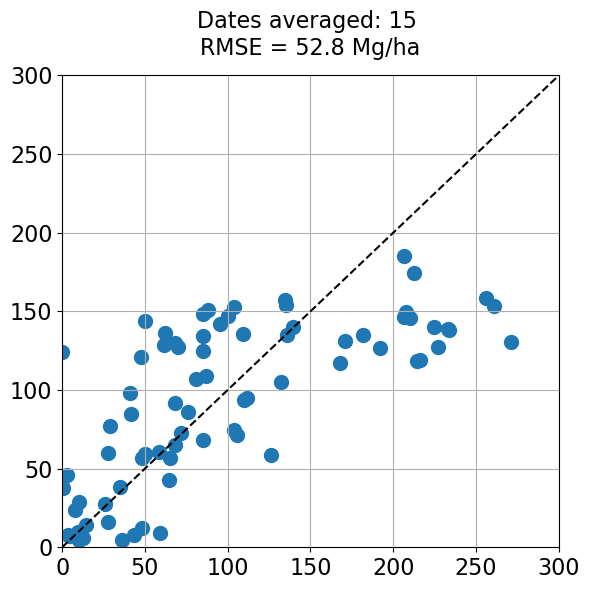

In [23]:
_=average_agb(t=15)

### Average over all acquisitions

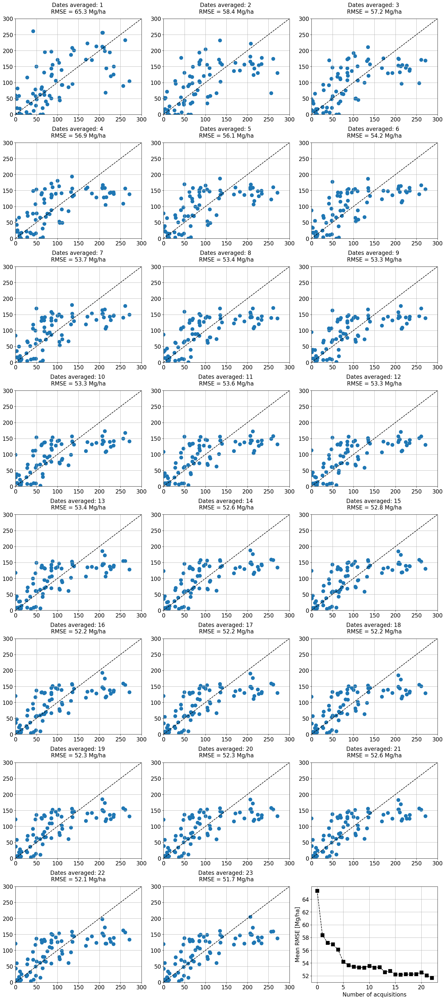

In [24]:
fig, axs = plt.subplots(8, 3, figsize=(18, 40))
avg_rmse = []
for t, ax in zip(range(m_t), axs.ravel()):
    t1=average_agb(t+1, ax)
    avg_rmse.append(t1)
avg_rmse = np.array(avg_rmse)
ax = axs.ravel()[-1]
ax.plot(np.arange(m_t), avg_rmse, marker='s', ls='--', color='k')
ax.set_xlabel('Number of acquisitions')
ax.set_ylabel('Mean RMSE [Mg/ha]')
ax.grid(True)

Text(0, 0.5, '% improvement in RMSE')

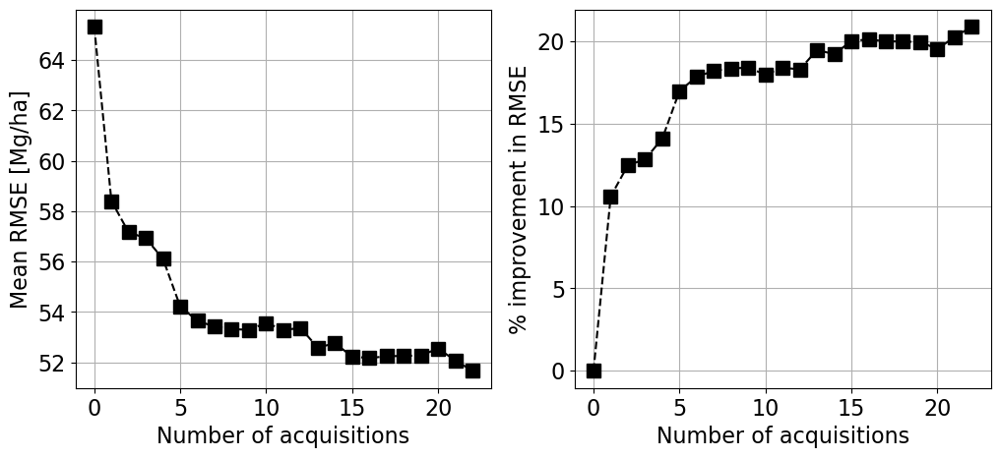

In [25]:
per_avg_rmse = [(avg_rmse[0]-avg_rmse[i])*100/avg_rmse[0] for i in range(m_t)]
fig, [ax, ax2] = plt.subplots(1, 2, figsize=(12, 5))
ax.plot(np.arange(m_t), avg_rmse, marker='s', ls='--', color='k')
ax.set_xlabel('Number of acquisitions')
ax.set_ylabel('Mean RMSE [Mg/ha]')
ax.grid(True)

ax2.plot(range(m_t), per_avg_rmse, marker='s', color='k', ls='--')
ax2.set_xlabel('Number of acquisitions')
ax2.set_ylabel('% improvement in RMSE')


In [26]:
# Run the WCM model over all acquisitions and save the WCM model parameters

dfC11, dfC22, AGB, m_t, df_field = read_alos2_data(max_agb=300)
print(f'Number of plots = {len(AGB)}')
mdl00 = Retrieval()
#y1 = dfC22.to_numpy()
#Train,test
def train_test_model():
    #Split data into test and train samples
    #Xtrain, Xtest, Ytrain, Ytest = train_test_split()
    y_train,y_test, agb_train, agb_test  = train_test_split(dfC22.to_numpy().T, AGB, test_size=0.4,
                                random_state = np.random.randint(10,1000),
                                shuffle = True)
    #Model training
    params, y_hat = mdl00.model_inverse(10*np.log10(y_train.T), agb_train )
    #Model inversion
    est = mdl00.data_inverse(y_test, params)
    rmse = [np.sqrt(mean_squared_error(est[i,:], agb_test)) for i in range(est.shape[0])]
    rsq = [r2_score(est[i,:], agb_test) for i in range(est.shape[0])]
    return params, y_hat, est, rmse, rsq, agb_test
#Estimating WCM parameters, estimated backscatter, estimated AGB etc for each acquisition
params = []
y_hat = []
est = []
rmse = []
rsq = []
#Iterating 30 times selecting random train/test samples
for iteration in tqdm(range(30)):
    
    a, b, c, d, e, agb_test = train_test_model()
    params.append(a)
    y_hat.append(b)
    est.append(c)
    rmse.append(d)
    rsq.append(e)
params = np.array(params)
param_file = pd.DataFrame(np.mean(params, axis=0), columns=['A', 'B', 'C'], index=dates)
param_file.to_csv('/home/unmeshk/dat/Haldwani/anciliary/WCM_plot_parameters.csv')
param_std = pd.DataFrame(np.std(params, axis=0), columns=['A', 'B', 'C'], index=dates)
param_std.to_csv('/home/unmeshk/dat/Haldwani/anciliary/WCM_plot_parameters_std.csv')
y_hat = np.array(y_hat)
est = np.array(est)
rmse = np.array(rmse)
rsq = np.array(rsq)

Number of plots = 77


100%|██████████| 30/30 [00:01<00:00, 16.02it/s]


## Variation of WCM model parameters with SWI

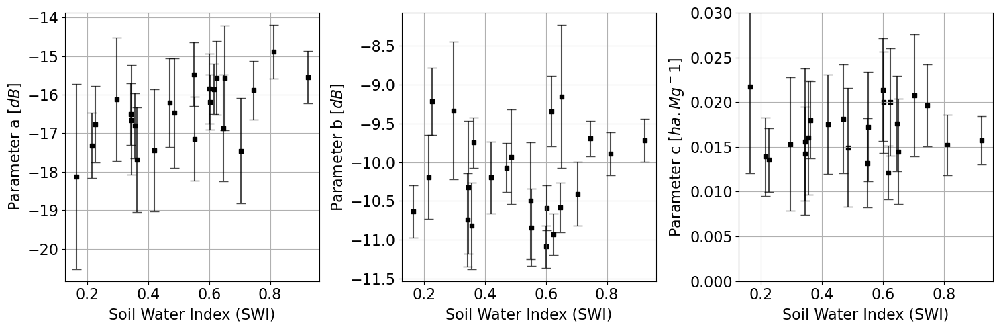

In [27]:
fig, axs = plt.subplots(1,3, figsize=(15,5))
units = ['$dB$', '$dB$', '$ha.Mg^-1$']
pars=['SWI_ASCAT', 'SWI_ASCAT','SWI_ASCAT','wind_speed', 'wind_speed']
import string
alphabet_string = list(string.ascii_uppercase)
for ax, col, unit, alp, par  in zip(axs.ravel(), param_file.columns, units, alphabet_string, pars):
    s=ax.scatter(dfL[par], param_file[col], c = 'k', cmap='viridis',marker='s', vmin=0, vmax=0.03, s=15)
    ax.errorbar(dfL[par], param_file[col], param_std[col], 
                 color='k', ls='none', capsize=5, marker='', markersize=5, alpha=0.7)
    ax.set_ylabel(f'Parameter {alp.lower()} [{unit}]')
    ax.set_xlabel('Soil Water Index (SWI)')
#axs[1].set_xlabel('Wind speed (m/s)')
#axs[2].set_xlabel('Wind speed (m/s)')

ax = axs.ravel()[-1]
ax.set_ylim(0.0, 0.03)
plt.tight_layout()
#plt.colorbar(s)


## Generating AGB Maps

In [28]:
param_file

,A,B,C
2014-09-21,-15.851341,-9.343651,0.012132
2014-11-30,-16.505989,-10.741714,0.014204
2015-07-12,-15.882231,-9.696126,0.019621
2015-09-20,-17.148062,-10.839768,0.017275
2015-11-29,-16.807663,-10.818759,0.016031
2016-02-07,-17.316979,-10.191291,0.013906
2016-07-10,-17.456900,-10.405917,0.020772
2016-09-18,-15.843884,-11.087265,0.021380
2017-02-05,-16.208650,-10.068914,0.018139
2017-09-17,-16.196185,-10.589054,0.019987


In [29]:
def agb_map_inversion(bs, params, i): #backscatter, WCM parameters, index
    A = params.A.iloc[i]
    B = params.B.iloc[i]
    C = params.C.iloc[i]
    print(A, B, C)
    y1 = 10**(bs/10)
    dummy_agb  = (y1*100)**2
    #print(A, B, C, A.shape)
    agb=(-1/C)*np.log((bs-B)/(A-B))
    agb[agb<0] = 0
    agb[np.isnan(agb)] = dummy_agb[np.isnan(agb)]
    return agb

In [30]:
#1. Obtain a Forest/Non-Forest mask
#Forest-non-forest mask
fnf = gdal.Open('/home/unmeshk/dat/Haldwani/ALOS2_subset/TDM_FNF_mosaic_ALOS2_subset.tif').ReadAsArray()


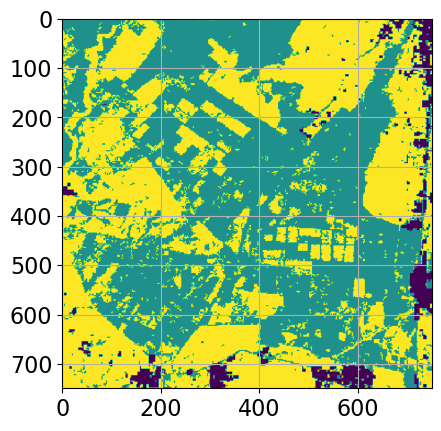

In [31]:
plt.imshow(fnf)

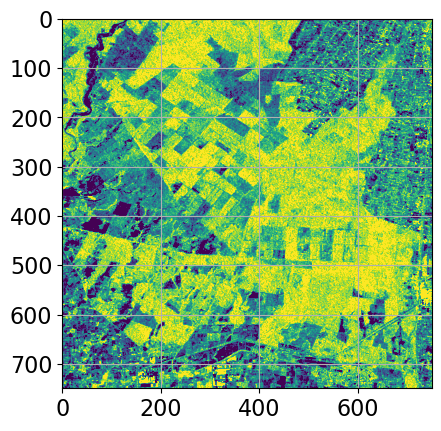

In [32]:
ds = gdal.Open('/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag.bin').ReadAsArray()
plt.imshow(10*np.log10(ds), vmin=-20, vmax=-10)

In [33]:
#2. Mapping AGB
#Here we take the WCM parameters, apply them to ALOS_2 data and generate a AGB
#This AGB is saved in GeoTiff using PLAnT functions
#Next we can check the accuracy of AGB generated
path = '/home/unmeshk/dat/Haldwani/ALOS2_subset/'
fnf_path = '/home/unmeshk/dat/Haldwani/ALOS2_subset/TDM_FNF_mosaic_ALOS2_subset.tif'
files = fnmatch.filter(os.listdir(path),"ALOS2_D_*_geo_25m_diag.bin") #HV backscatter
files.sort()
alos2_mosaic=[]
for i, file in enumerate(files):
    agb_file = path+file.split('.bin')[0]+'_AGB.tif'
    raster = plant.read_image(path+file)
    ds = gdal.Open(path+file).ReadAsArray()[:,:]
    ds = 10*np.log10(ds)
    agb = agb_map_inversion(ds, param_file, i)
    agb[agb>300]=300
    #Apply FNF
    ds = gdal.Open(fnf_path).ReadAsArray()
    agb[ds>1]=0
    #agb = agb*ds#Not applying FNF as TDM fnf is at 50m res and resampling it to 25m creates artifacts
    plant.save_image(agb, agb_file, force=True)
    plant.util(agb_file, path+file, import_geo=True, force=True, o=agb_file)
    alos2_mosaic.append(agb)
alos2_mosaic = np.array(alos2_mosaic)

-15.85134104687643 -9.343650850856902 0.012131689264228442
## file saved: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag_AGB.tif (GDAL:GTiff)
## output file(s):
##     /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag_AGB.tif
PLAnT 0.1.56dev - plant_util.py -i "/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag_AGB.tif" "/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag.bin" --import-geo -f -o "/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag_AGB.tif" --no-bash
input image(s): ['/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag_AGB.tif', '/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag.bin']
output image: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag_AGB.tif
opening: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140921_geo_25m_diag_AGB.tif (GDAL: GTiff) 
opening: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20140

## file saved: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag_AGB.tif (GDAL:GTiff)
PLAnT 0.1.56dev - plant_util.py -i "/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag_AGB.tif" "/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag.bin" --import-geo -f -o "/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag_AGB.tif" --no-bash
input image(s): ['/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag_AGB.tif', '/home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag.bin']
output image: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag_AGB.tif
opening: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag_AGB.tif (GDAL: GTiff) 
opening: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag.bin (GDAL: ENVI) 
file saved: /home/unmeshk/dat/Haldwani/ALOS2_subset/ALOS2_D_20180513_geo_25m_diag_AGB.tif (GDAL:GTiff)
output file(s):
    /home

## Display the AGB maps

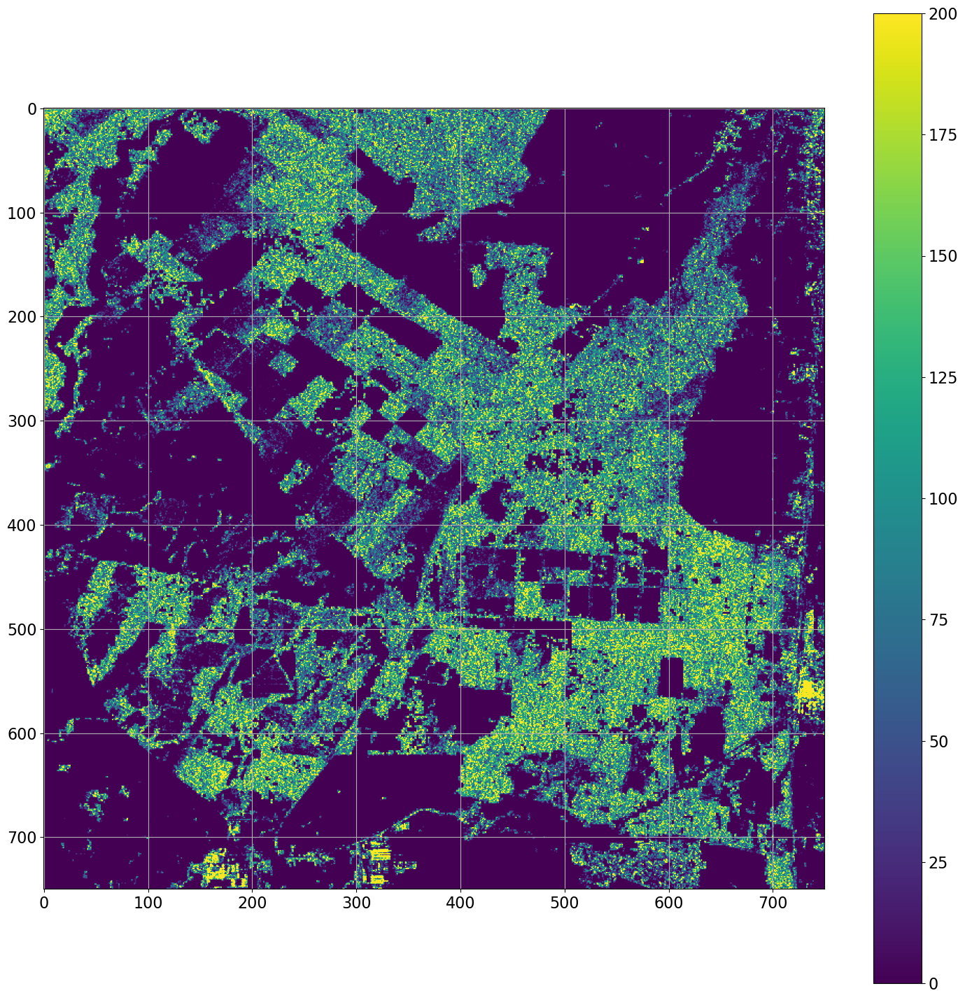

In [34]:
files = fnmatch.filter(os.listdir(path),"ALOS2_D_*_geo_25m_diag_AGB.tif") #HV backscatter
files.sort()

fig, ax = plt.subplots(1,1,figsize=(18,18))
ds = gdal.Open(path+files[10]).ReadAsArray()
s=ax.imshow(ds, cmap='viridis', vmin=0, vmax=200)
plt.colorbar(s)

## Taking the average AGB over all images and displaying the AGB map

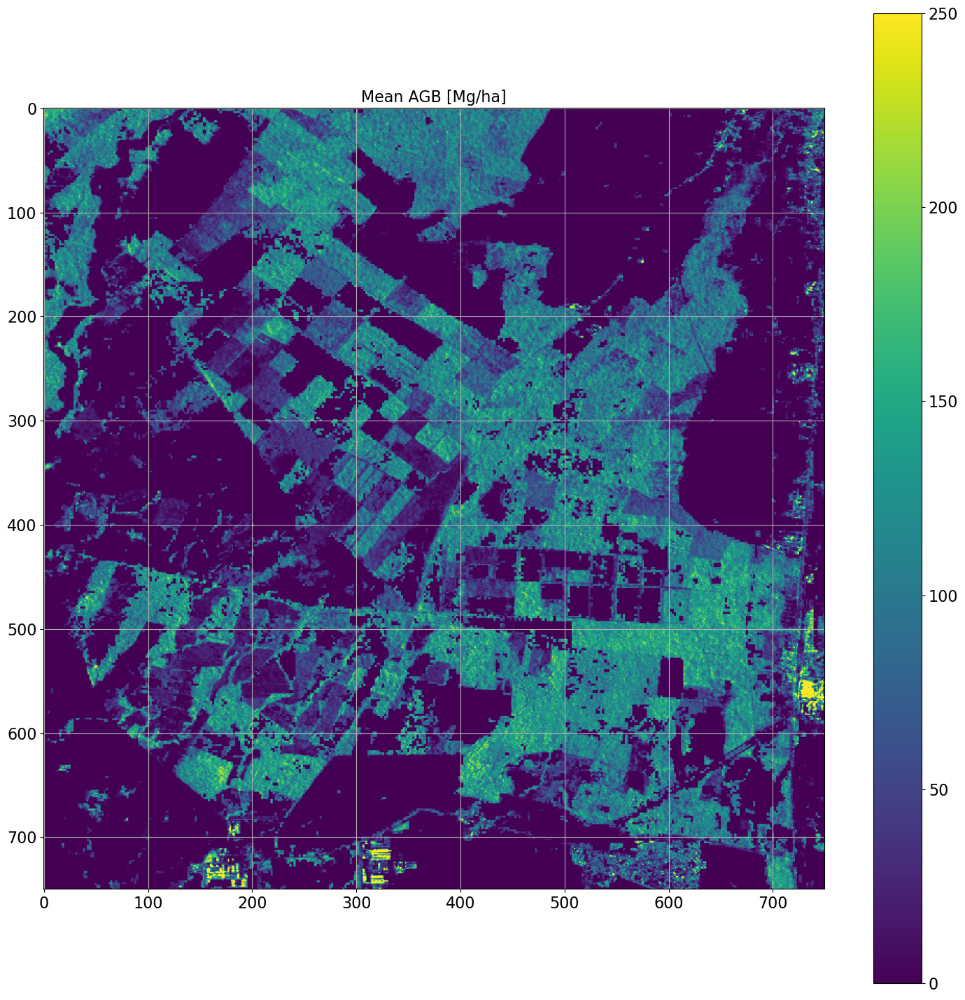

In [35]:
mean_agb = np.nanmean(alos2_mosaic, axis=0)
fig, ax = plt.subplots(1,1,figsize=(18,18))
s=ax.imshow(mean_agb, cmap='viridis', vmin=0, vmax=250)
ax.set_title('Mean AGB [Mg/ha]')
plt.colorbar(s)

## Comparing with available open source AGB map
### Over this site, the GlobBiomass by Santoro et. al., 2010 is available

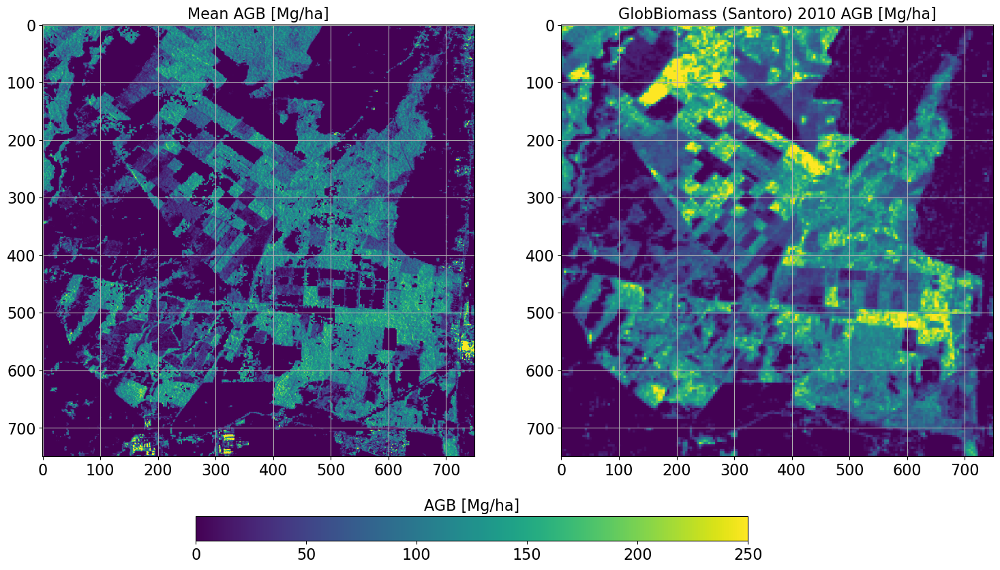

In [36]:
fig, [ax, ax2] = plt.subplots(1,2,figsize=(18,18))
s=ax.imshow(mean_agb, cmap='viridis', vmin=0, vmax=250)
ax.set_title('Mean AGB [Mg/ha]')
ext_agb = gdal.Open(path+'Santoro_2010_agb_map.tif').ReadAsArray()
s2 = ax2.imshow(ext_agb, cmap='viridis', vmin=0, vmax=250)
ax2.set_title('GlobBiomass (Santoro) 2010 AGB [Mg/ha]')
cbar_ax = fig.add_axes([0.25, 0.25, 0.45, 0.02])
cbar = fig.colorbar(s, cax=cbar_ax,orientation='horizontal', ax=ax)
_=cbar.ax.set_title('AGB [Mg/ha]')